<a href="https://colab.research.google.com/github/Shehab37/gans/blob/main/works_well_tf_dcgan__cifar_10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf

In [2]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display

In [3]:
(train_images, train_labels), (_, _) = tf.keras.datasets.cifar10.load_data()
train_images = train_images.reshape(train_images.shape[0], 32, 32, 3).astype('float32')
train_images = (train_images - 127.5) / 127.5 # Normalize the images to [-1, 1]
BUFFER_SIZE = 50000
BATCH_SIZE = 256
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)


170508288/170498071 [==============================] - 3s 0us/step


In [4]:
train_images.shape

(50000, 32, 32, 3)

In [5]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((8, 8, 256)))
    assert model.output_shape == (None, 8, 8, 256) # Note: None is the batch size

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 8, 8, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 16, 16, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 32, 32, 3)

    return model

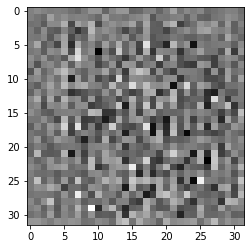

In [6]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [7]:
generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 16384)             1638400   
                                                                 
 batch_normalization (BatchN  (None, 16384)            65536     
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 16384)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 256)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 8, 8, 128)        819200    
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 8, 8, 128)        5

In [8]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

In [9]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)
discriminator.summary()

tf.Tensor([[0.00037485]], shape=(1, 1), dtype=float32)
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 16, 16, 64)        4864      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 dropout (Dropout)           (None, 16, 16, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 128)         204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 dropout_1 (Dropout)         (None, 8, 8, 128)         0         
                                                                 

In [10]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)


In [11]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [12]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [13]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [14]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [15]:
EPOCHS = 3
noise_dim = 100
num_examples_to_generate = 16

# We will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [16]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [17]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as we go
    # display.clear_output(wait=True)
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  # display.clear_output(wait=True)
  generate_and_save_images(generator,
                           epochs,
                           seed)

In [18]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4,4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5)
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

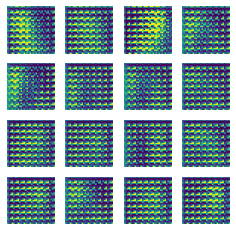

Time for epoch 1 is 15.515606880187988 sec


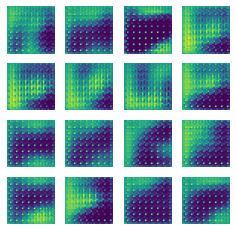

Time for epoch 2 is 12.054225206375122 sec


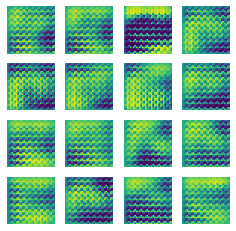

Time for epoch 3 is 12.005904197692871 sec


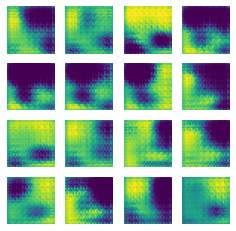

Time for epoch 4 is 12.09825086593628 sec


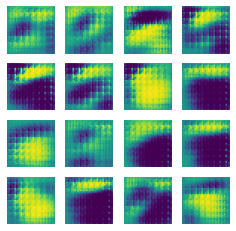

Time for epoch 5 is 12.504132747650146 sec


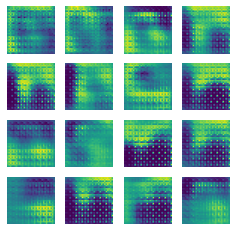

Time for epoch 6 is 12.414259195327759 sec


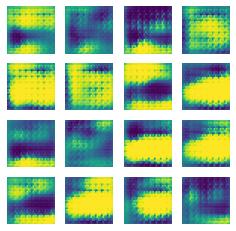

Time for epoch 7 is 12.590977191925049 sec


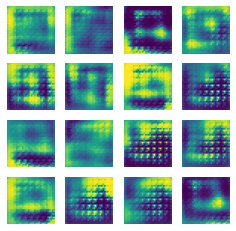

Time for epoch 8 is 12.69948959350586 sec


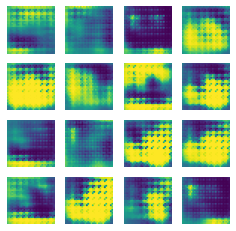

Time for epoch 9 is 12.906753540039062 sec


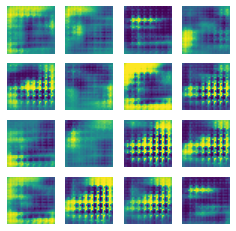

Time for epoch 10 is 12.726530313491821 sec


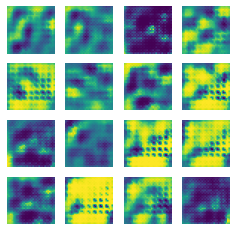

Time for epoch 11 is 12.721176624298096 sec


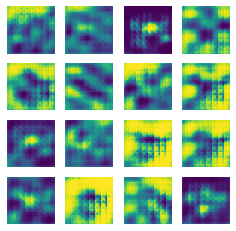

Time for epoch 12 is 12.774847269058228 sec


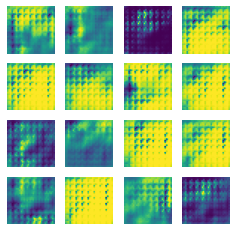

Time for epoch 13 is 12.946686506271362 sec


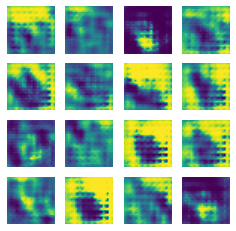

Time for epoch 14 is 12.722131490707397 sec


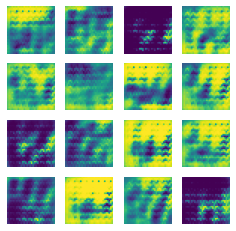

Time for epoch 15 is 12.880627155303955 sec


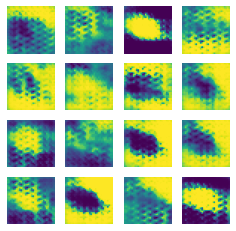

Time for epoch 16 is 12.912834405899048 sec


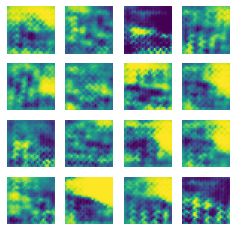

Time for epoch 17 is 12.784506797790527 sec


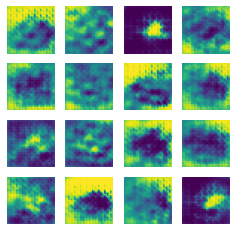

Time for epoch 18 is 12.758549213409424 sec


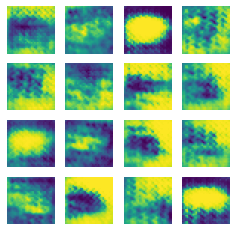

Time for epoch 19 is 12.760499238967896 sec


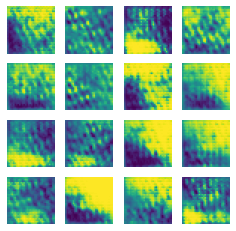

Time for epoch 20 is 12.989042282104492 sec


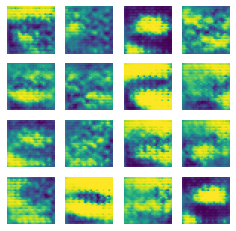

Time for epoch 21 is 12.778823614120483 sec


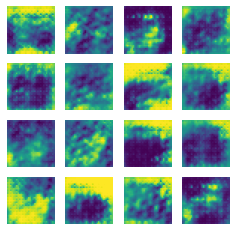

Time for epoch 22 is 12.766315698623657 sec


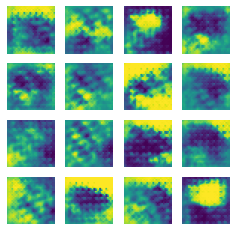

Time for epoch 23 is 12.78445291519165 sec


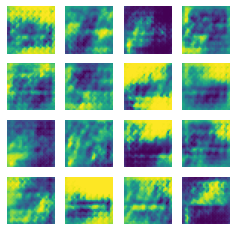

Time for epoch 24 is 12.987638235092163 sec


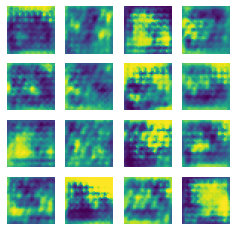

Time for epoch 25 is 12.764679908752441 sec


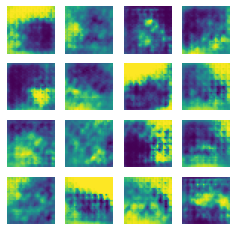

Time for epoch 26 is 12.760928630828857 sec


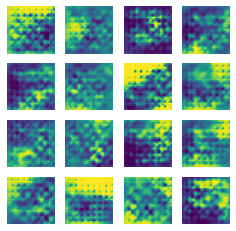

Time for epoch 27 is 12.938292026519775 sec


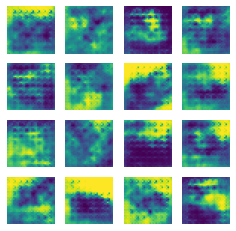

Time for epoch 28 is 12.80493688583374 sec


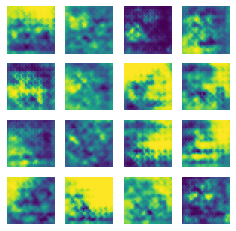

Time for epoch 29 is 12.780658721923828 sec


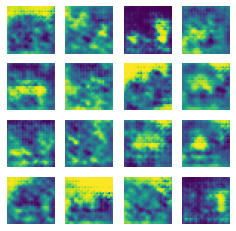

Time for epoch 30 is 12.866000175476074 sec


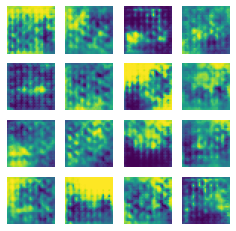

Time for epoch 31 is 12.944880723953247 sec


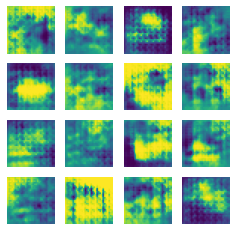

Time for epoch 32 is 12.912950277328491 sec


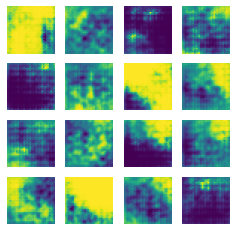

Time for epoch 33 is 12.76408338546753 sec


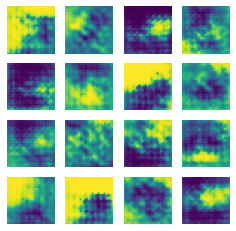

Time for epoch 34 is 12.775466203689575 sec


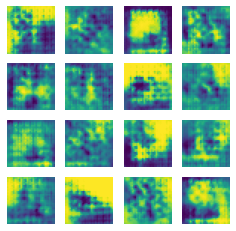

Time for epoch 35 is 12.995440483093262 sec


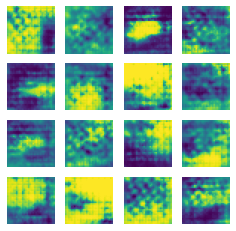

Time for epoch 36 is 12.757191181182861 sec


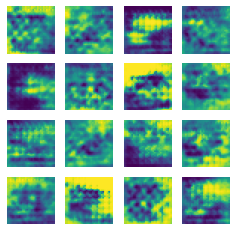

Time for epoch 37 is 12.771315574645996 sec


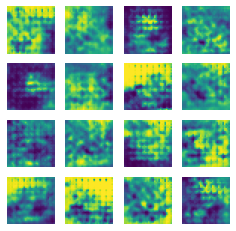

Time for epoch 38 is 12.961857080459595 sec


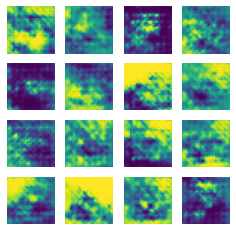

Time for epoch 39 is 12.789746284484863 sec


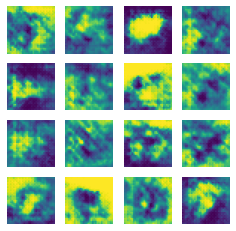

Time for epoch 40 is 12.736622333526611 sec


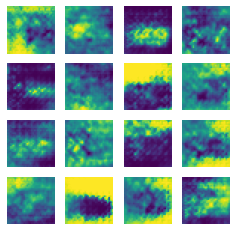

Time for epoch 41 is 12.76452898979187 sec


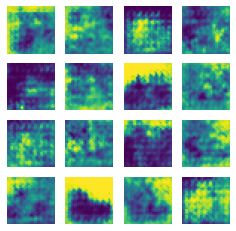

Time for epoch 42 is 12.97267746925354 sec


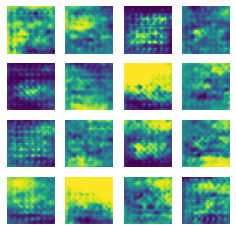

Time for epoch 43 is 12.774939060211182 sec


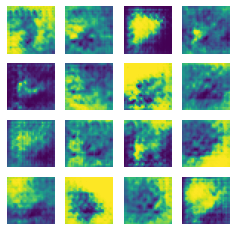

Time for epoch 44 is 12.78617000579834 sec


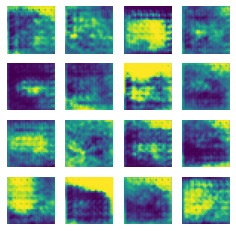

Time for epoch 45 is 12.908379793167114 sec


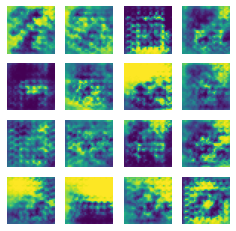

Time for epoch 46 is 12.925901889801025 sec


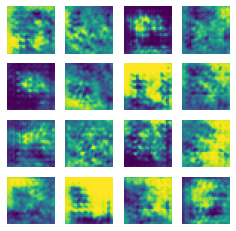

Time for epoch 47 is 12.783833980560303 sec


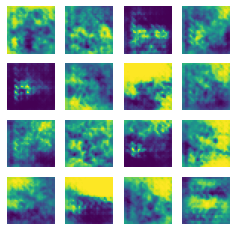

Time for epoch 48 is 12.78804898262024 sec


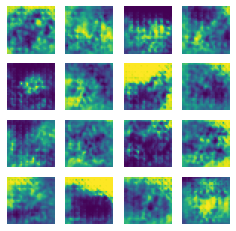

Time for epoch 49 is 12.967883825302124 sec


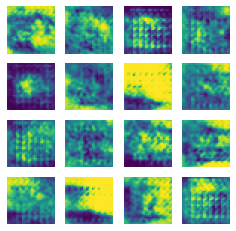

Time for epoch 50 is 12.768162250518799 sec


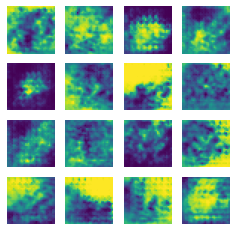

Time for epoch 51 is 12.792551755905151 sec


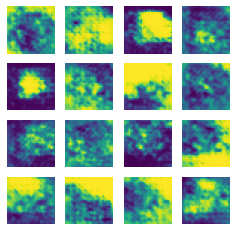

Time for epoch 52 is 12.785203695297241 sec


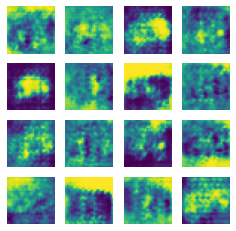

Time for epoch 53 is 13.00403356552124 sec


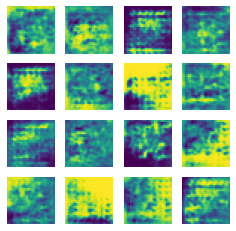

Time for epoch 54 is 12.790823221206665 sec


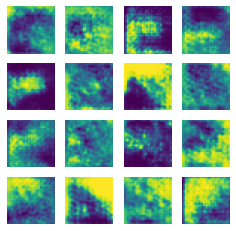

Time for epoch 55 is 12.785011529922485 sec


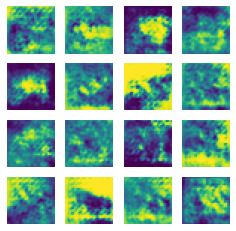

Time for epoch 56 is 12.799556732177734 sec


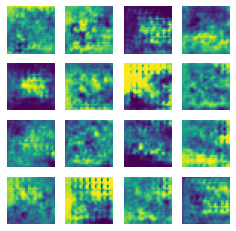

Time for epoch 57 is 13.002968549728394 sec


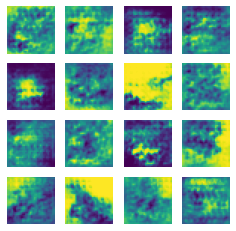

Time for epoch 58 is 12.801123142242432 sec


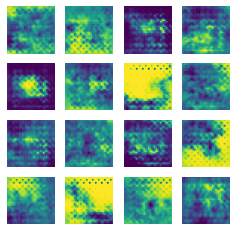

Time for epoch 59 is 12.800421953201294 sec


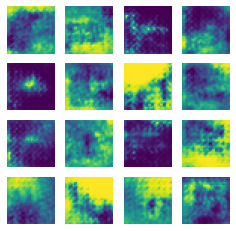

Time for epoch 60 is 13.057533502578735 sec


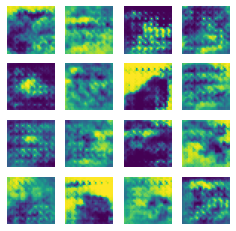

Time for epoch 61 is 12.753662347793579 sec


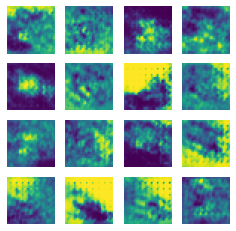

Time for epoch 62 is 12.790282249450684 sec


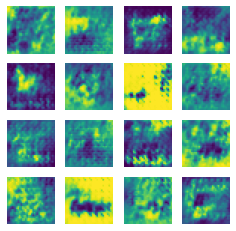

Time for epoch 63 is 12.784909963607788 sec


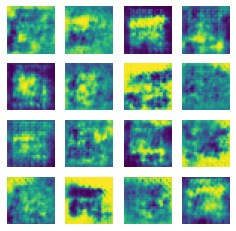

Time for epoch 64 is 13.032983303070068 sec


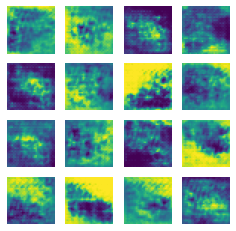

Time for epoch 65 is 12.798055648803711 sec


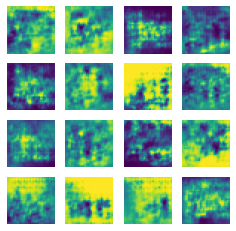

Time for epoch 66 is 12.787140846252441 sec


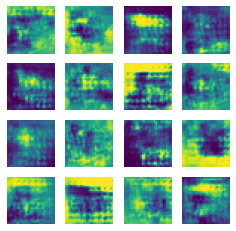

Time for epoch 67 is 12.804840326309204 sec


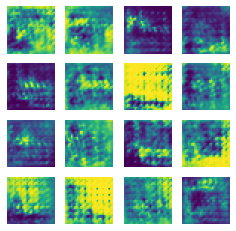

Time for epoch 68 is 13.010018348693848 sec


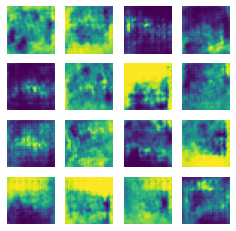

Time for epoch 69 is 12.83692717552185 sec


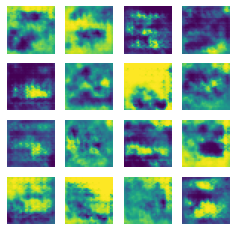

Time for epoch 70 is 12.876276016235352 sec


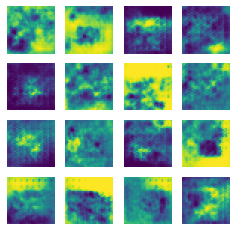

Time for epoch 71 is 13.004977941513062 sec


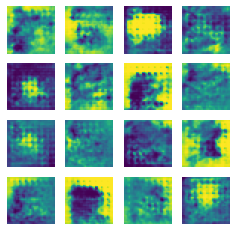

Time for epoch 72 is 12.790477991104126 sec


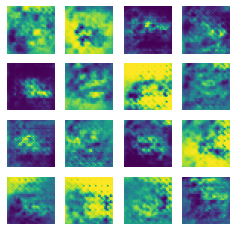

Time for epoch 73 is 12.793092250823975 sec


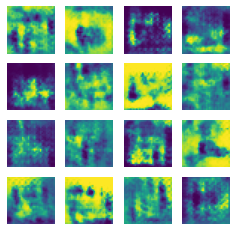

Time for epoch 74 is 12.823706150054932 sec


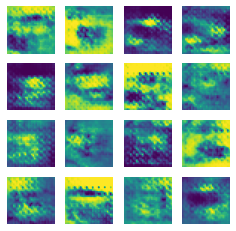

Time for epoch 75 is 13.138281345367432 sec


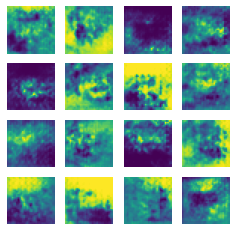

Time for epoch 76 is 12.752533197402954 sec


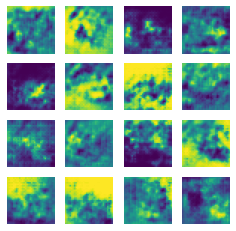

Time for epoch 77 is 12.8134605884552 sec


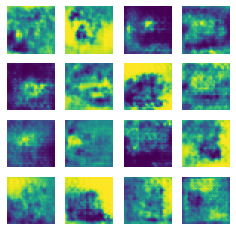

Time for epoch 78 is 12.795027256011963 sec


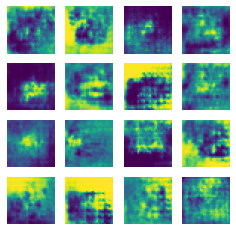

Time for epoch 79 is 12.9771888256073 sec


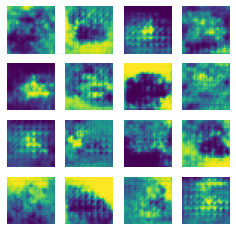

Time for epoch 80 is 12.817612886428833 sec


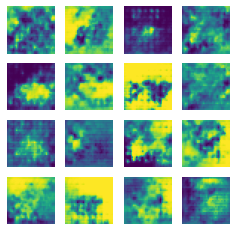

Time for epoch 81 is 12.790143728256226 sec


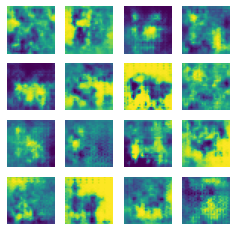

Time for epoch 82 is 12.984623193740845 sec


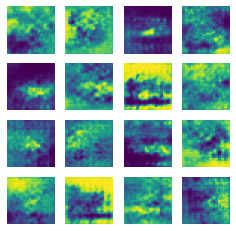

Time for epoch 83 is 12.80992317199707 sec


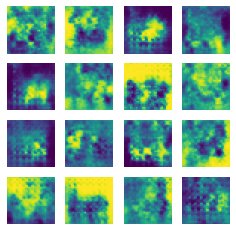

Time for epoch 84 is 12.813809394836426 sec


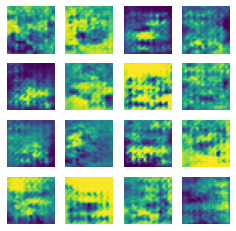

Time for epoch 85 is 12.803051710128784 sec


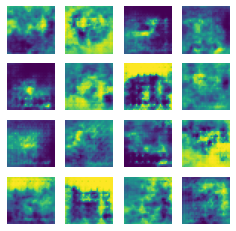

Time for epoch 86 is 13.038068294525146 sec


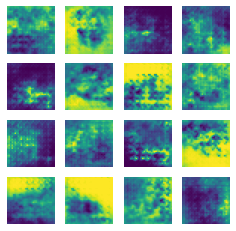

Time for epoch 87 is 12.790207862854004 sec


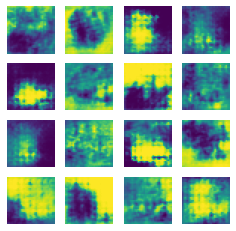

Time for epoch 88 is 12.789154052734375 sec


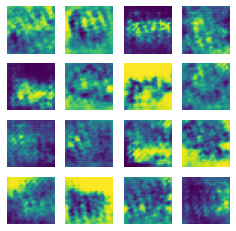

Time for epoch 89 is 12.780688762664795 sec


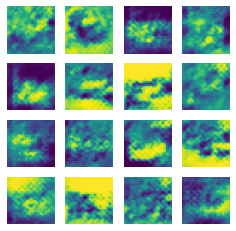

Time for epoch 90 is 13.131295919418335 sec


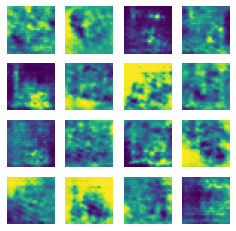

Time for epoch 91 is 12.798058271408081 sec


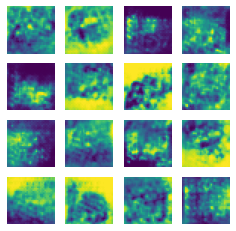

Time for epoch 92 is 12.803182125091553 sec


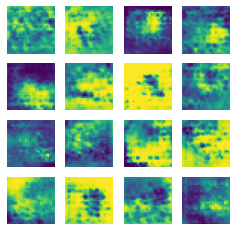

Time for epoch 93 is 13.009011507034302 sec


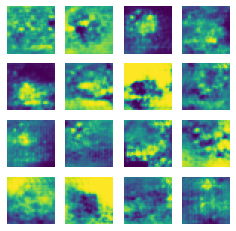

Time for epoch 94 is 12.829031467437744 sec


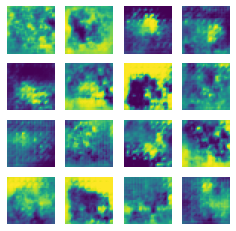

Time for epoch 95 is 12.83308219909668 sec


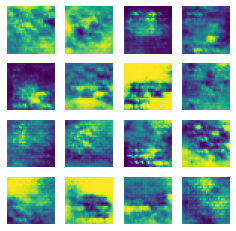

Time for epoch 96 is 12.829818487167358 sec


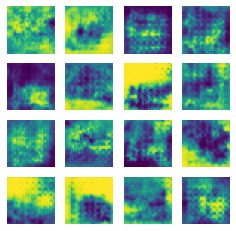

Time for epoch 97 is 13.025610446929932 sec


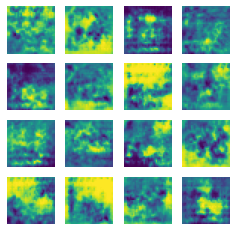

Time for epoch 98 is 12.794165134429932 sec


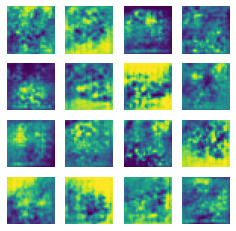

Time for epoch 99 is 12.83007287979126 sec


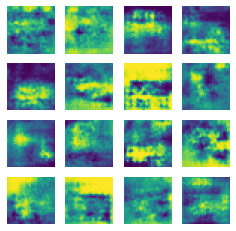

Time for epoch 100 is 12.795852184295654 sec


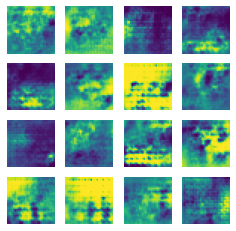

Time for epoch 101 is 13.028730392456055 sec


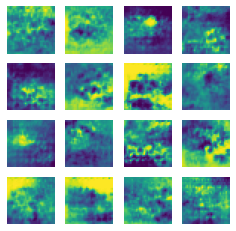

Time for epoch 102 is 12.837124824523926 sec


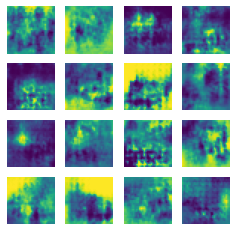

Time for epoch 103 is 12.813576936721802 sec


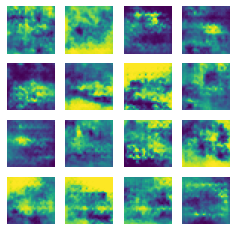

Time for epoch 104 is 13.012505054473877 sec


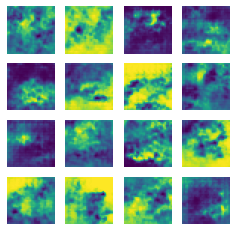

Time for epoch 105 is 12.94337773323059 sec


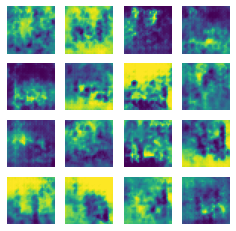

Time for epoch 106 is 12.896675109863281 sec


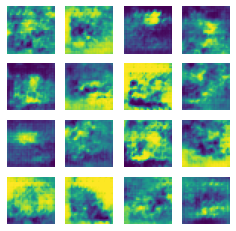

Time for epoch 107 is 12.790389060974121 sec


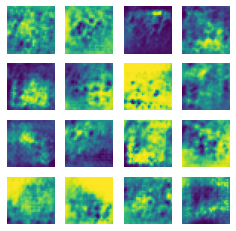

Time for epoch 108 is 13.02723217010498 sec


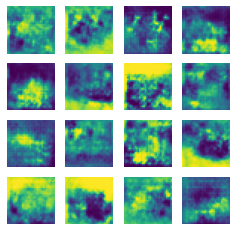

Time for epoch 109 is 12.805716276168823 sec


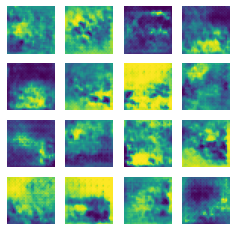

Time for epoch 110 is 12.822467803955078 sec


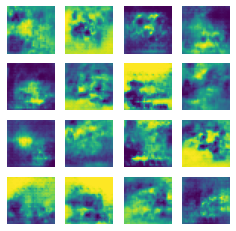

Time for epoch 111 is 12.831970691680908 sec


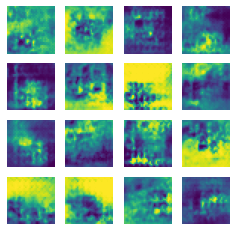

Time for epoch 112 is 13.080985307693481 sec


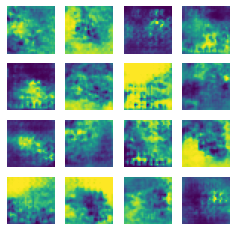

Time for epoch 113 is 12.81964898109436 sec


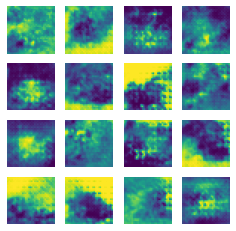

Time for epoch 114 is 12.811885833740234 sec


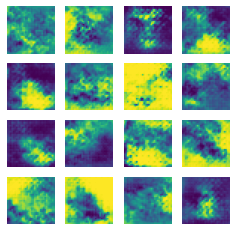

Time for epoch 115 is 13.026814222335815 sec


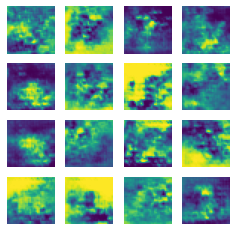

Time for epoch 116 is 12.830738544464111 sec


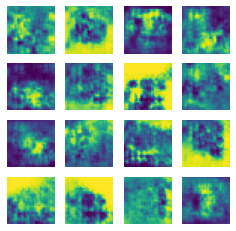

Time for epoch 117 is 12.857300996780396 sec


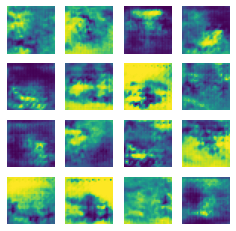

Time for epoch 118 is 12.835672855377197 sec


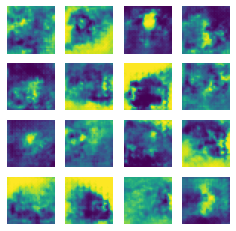

Time for epoch 119 is 13.032731294631958 sec


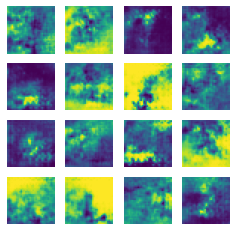

Time for epoch 120 is 12.954415798187256 sec


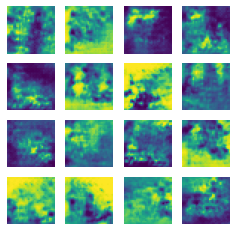

Time for epoch 121 is 12.792098045349121 sec


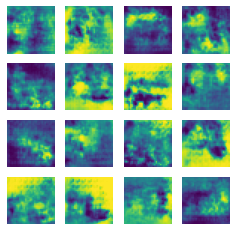

Time for epoch 122 is 12.870797634124756 sec


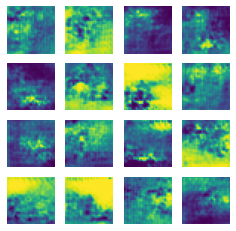

Time for epoch 123 is 13.071872234344482 sec


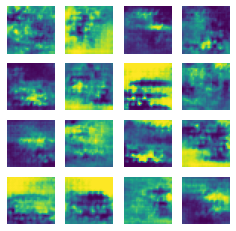

Time for epoch 124 is 12.89183497428894 sec


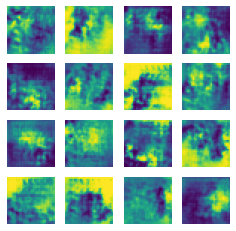

Time for epoch 125 is 12.851203441619873 sec


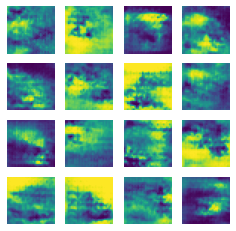

Time for epoch 126 is 12.995625972747803 sec


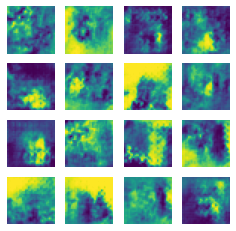

Time for epoch 127 is 12.864051818847656 sec


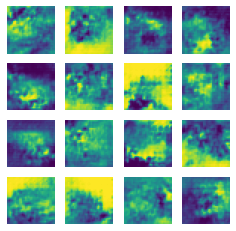

Time for epoch 128 is 12.881083726882935 sec


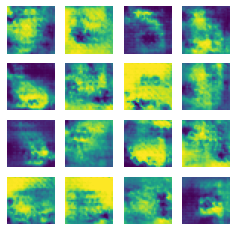

Time for epoch 129 is 12.826852321624756 sec


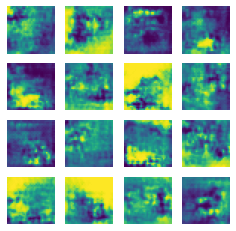

Time for epoch 130 is 13.078263282775879 sec


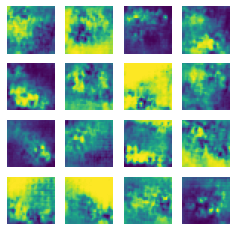

Time for epoch 131 is 12.836428880691528 sec


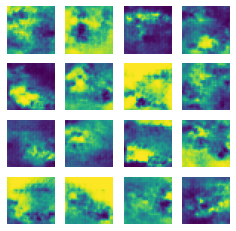

Time for epoch 132 is 12.850986242294312 sec


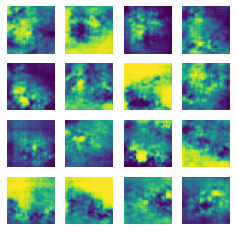

Time for epoch 133 is 12.871002197265625 sec


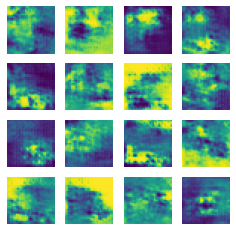

Time for epoch 134 is 13.050479650497437 sec


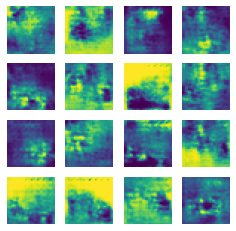

Time for epoch 135 is 12.908767700195312 sec


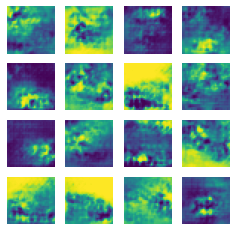

Time for epoch 136 is 12.804821729660034 sec


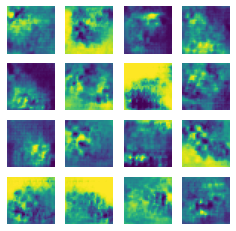

Time for epoch 137 is 13.06529450416565 sec


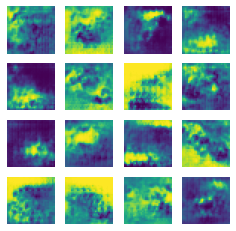

Time for epoch 138 is 12.853781938552856 sec


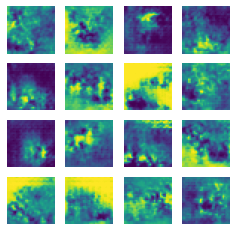

Time for epoch 139 is 12.848688125610352 sec


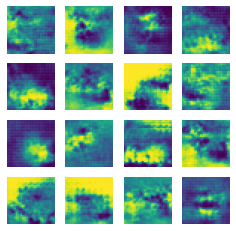

Time for epoch 140 is 12.853639364242554 sec


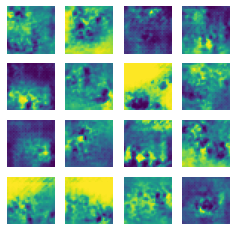

Time for epoch 141 is 13.020268201828003 sec


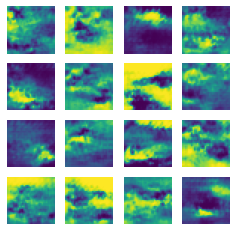

Time for epoch 142 is 12.842212915420532 sec


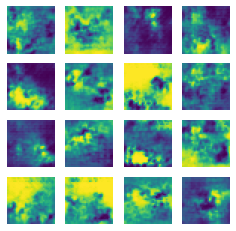

Time for epoch 143 is 12.887598991394043 sec


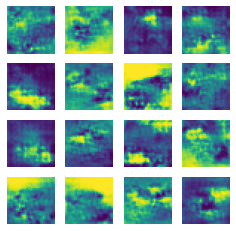

Time for epoch 144 is 12.856411695480347 sec


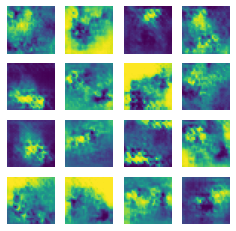

Time for epoch 145 is 13.054847240447998 sec


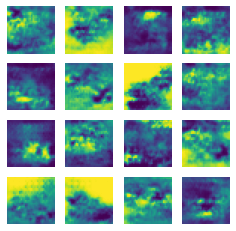

Time for epoch 146 is 12.836251497268677 sec


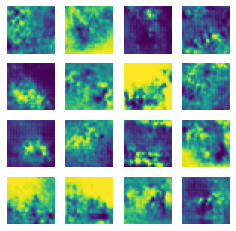

Time for epoch 147 is 12.873665809631348 sec


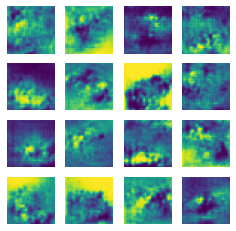

Time for epoch 148 is 13.074416160583496 sec


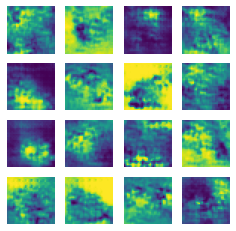

Time for epoch 149 is 12.8948335647583 sec


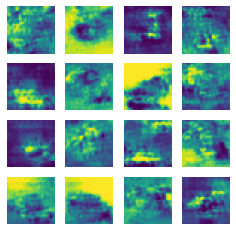

Time for epoch 150 is 13.004769086837769 sec


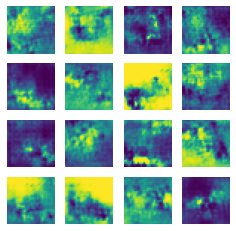

Time for epoch 151 is 12.846021890640259 sec


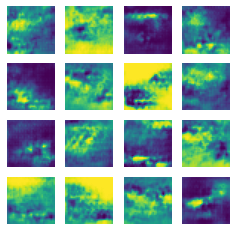

Time for epoch 152 is 13.104001760482788 sec


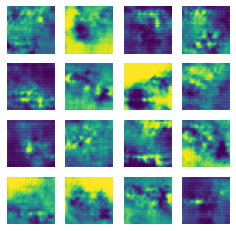

Time for epoch 153 is 12.951140880584717 sec


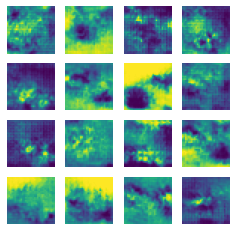

Time for epoch 154 is 12.933156967163086 sec


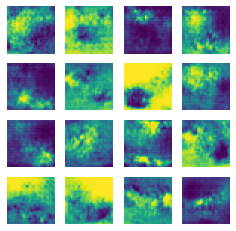

Time for epoch 155 is 12.907652378082275 sec


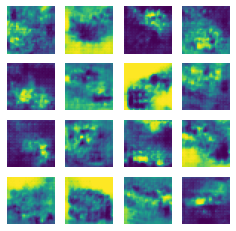

Time for epoch 156 is 13.091930150985718 sec


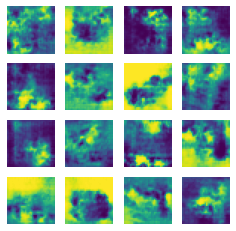

Time for epoch 157 is 12.862500667572021 sec


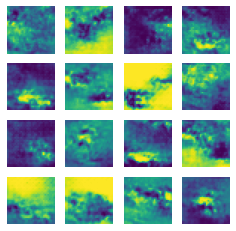

Time for epoch 158 is 12.912931680679321 sec


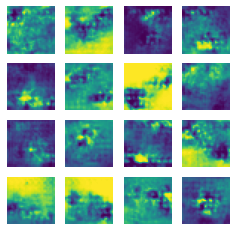

Time for epoch 159 is 13.133541345596313 sec


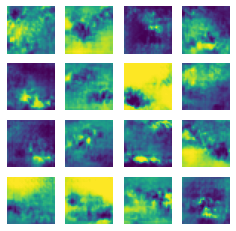

Time for epoch 160 is 12.89659309387207 sec


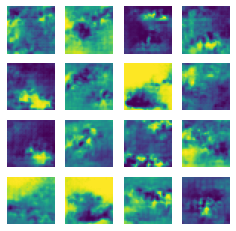

Time for epoch 161 is 12.89259147644043 sec


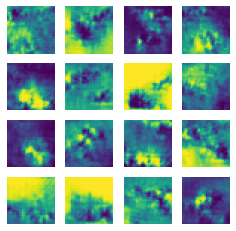

Time for epoch 162 is 12.908868789672852 sec


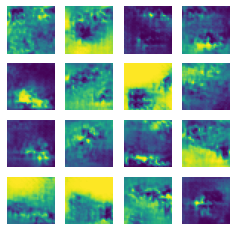

Time for epoch 163 is 13.09187388420105 sec


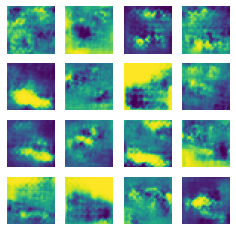

Time for epoch 164 is 12.903557538986206 sec


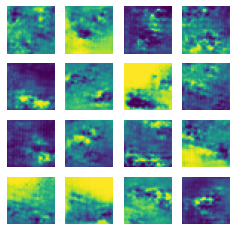

Time for epoch 165 is 13.033146858215332 sec


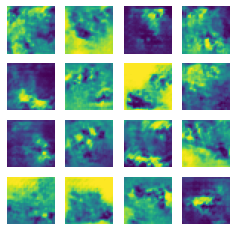

Time for epoch 166 is 12.865938663482666 sec


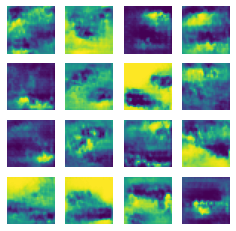

Time for epoch 167 is 13.115325450897217 sec


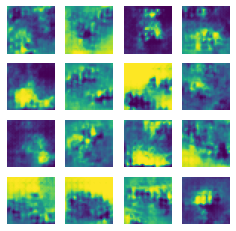

Time for epoch 168 is 12.924619674682617 sec


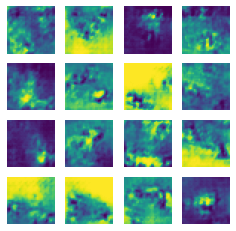

Time for epoch 169 is 12.91560435295105 sec


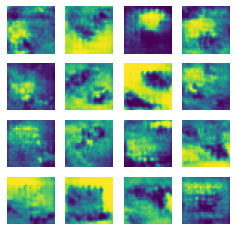

Time for epoch 170 is 13.095747947692871 sec


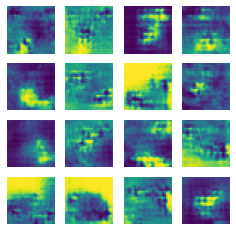

Time for epoch 171 is 12.919083595275879 sec


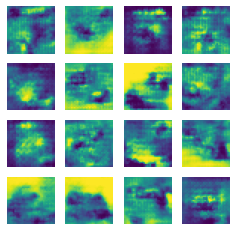

Time for epoch 172 is 12.88936185836792 sec


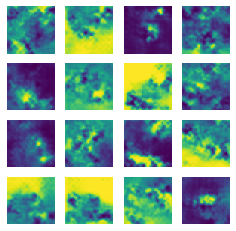

Time for epoch 173 is 12.905555009841919 sec


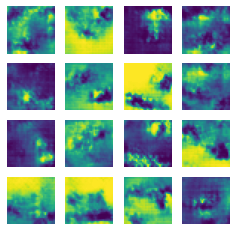

Time for epoch 174 is 21.703988075256348 sec


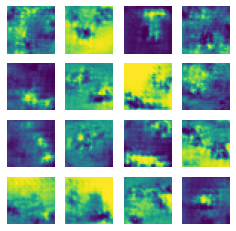

Time for epoch 175 is 12.974182605743408 sec


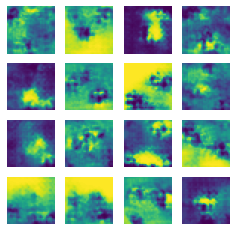

Time for epoch 176 is 13.033045530319214 sec


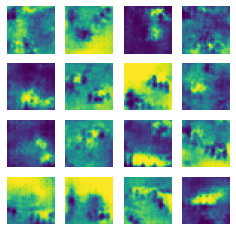

Time for epoch 177 is 12.981933355331421 sec


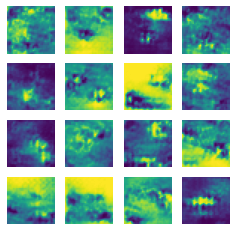

Time for epoch 178 is 13.171204805374146 sec


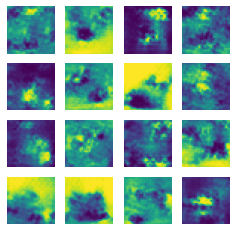

Time for epoch 179 is 12.943582534790039 sec


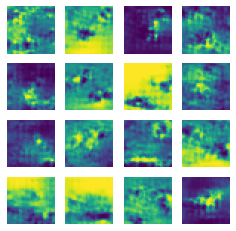

Time for epoch 180 is 13.021818399429321 sec


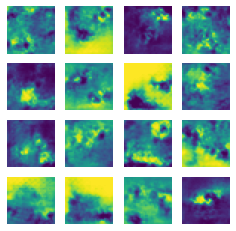

Time for epoch 181 is 13.090543031692505 sec


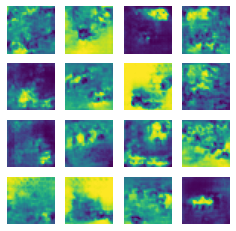

Time for epoch 182 is 12.930857419967651 sec


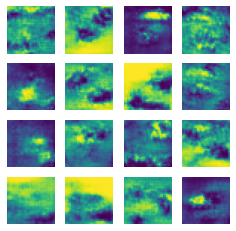

Time for epoch 183 is 12.909127950668335 sec


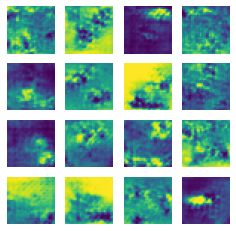

Time for epoch 184 is 12.948935508728027 sec


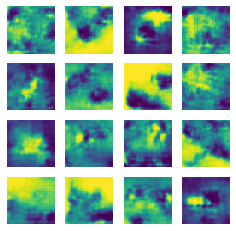

Time for epoch 185 is 13.171441078186035 sec


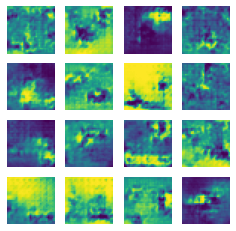

Time for epoch 186 is 12.926212310791016 sec


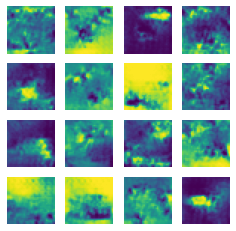

Time for epoch 187 is 12.912089824676514 sec


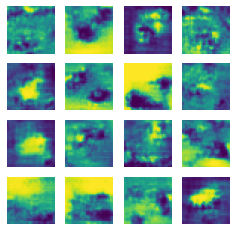

Time for epoch 188 is 12.943922758102417 sec


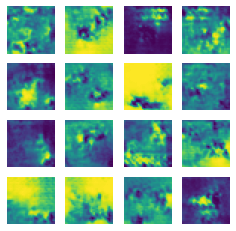

Time for epoch 189 is 21.682312488555908 sec


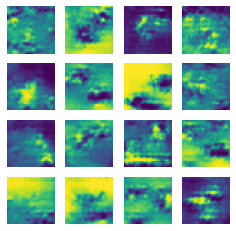

Time for epoch 190 is 12.972438335418701 sec


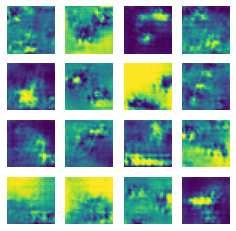

Time for epoch 191 is 12.991342067718506 sec


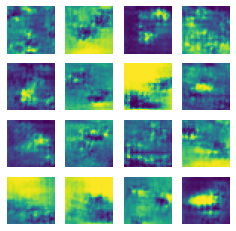

Time for epoch 192 is 13.175854206085205 sec


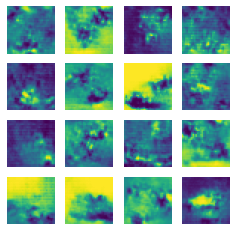

Time for epoch 193 is 12.940760850906372 sec


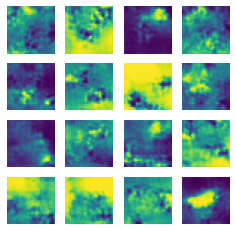

Time for epoch 194 is 12.93700623512268 sec


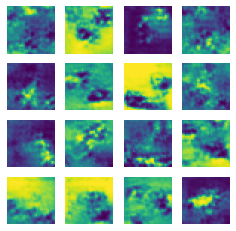

Time for epoch 195 is 12.99290132522583 sec


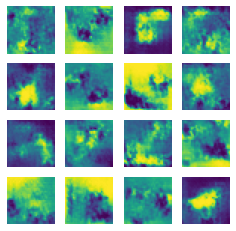

Time for epoch 196 is 13.120420932769775 sec


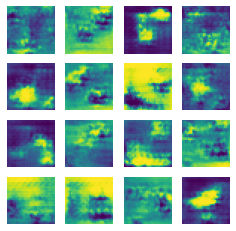

Time for epoch 197 is 12.951549768447876 sec


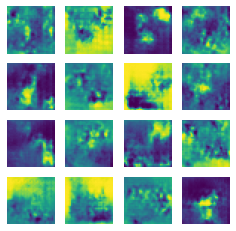

Time for epoch 198 is 12.980519533157349 sec


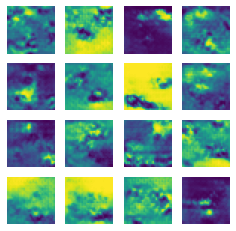

Time for epoch 199 is 12.979820966720581 sec


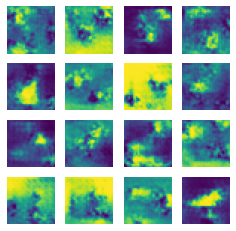

Time for epoch 200 is 13.122346878051758 sec


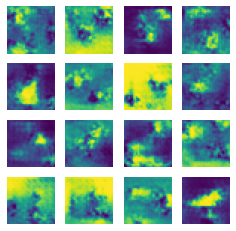

In [19]:
train(train_dataset, 200)


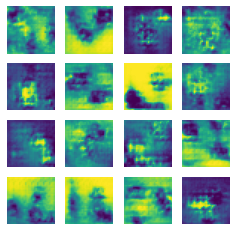

Time for epoch 1 is 12.840149164199829 sec


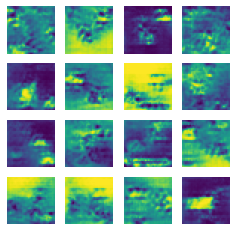

Time for epoch 2 is 12.935871362686157 sec


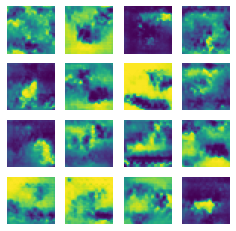

Time for epoch 3 is 12.769298315048218 sec


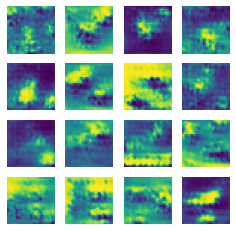

Time for epoch 4 is 12.726057291030884 sec


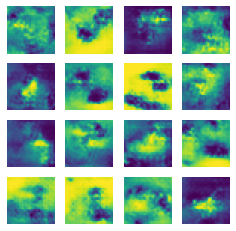

Time for epoch 5 is 12.742813348770142 sec


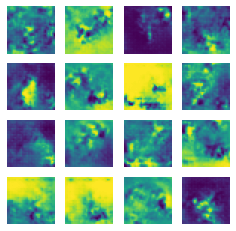

Time for epoch 6 is 12.943365812301636 sec


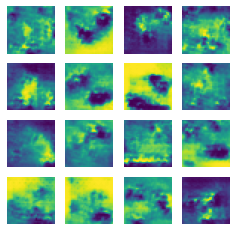

Time for epoch 7 is 12.73173189163208 sec


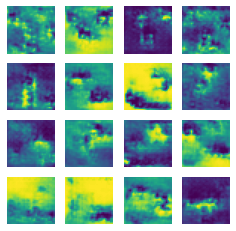

Time for epoch 8 is 12.764867305755615 sec


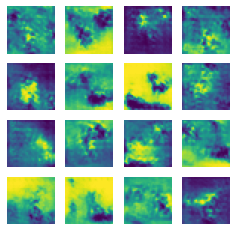

Time for epoch 9 is 12.748868942260742 sec


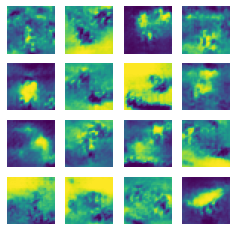

Time for epoch 10 is 12.962405443191528 sec


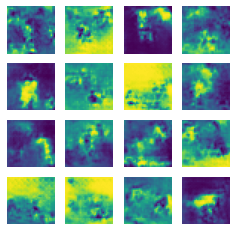

Time for epoch 11 is 12.714826583862305 sec


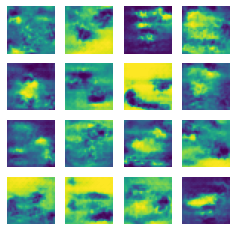

Time for epoch 12 is 12.720781326293945 sec


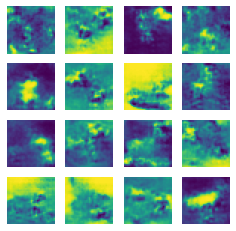

Time for epoch 13 is 12.925882816314697 sec


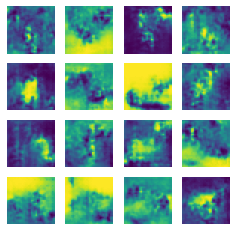

Time for epoch 14 is 12.752508640289307 sec


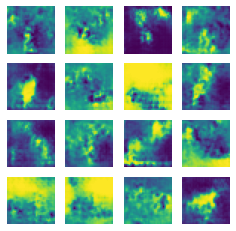

Time for epoch 15 is 12.870997190475464 sec


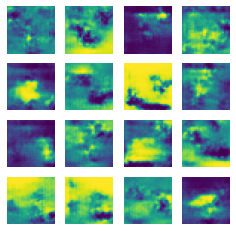

Time for epoch 16 is 12.73914647102356 sec


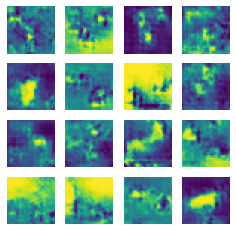

Time for epoch 17 is 12.96207594871521 sec


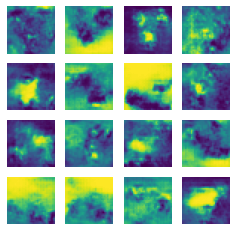

Time for epoch 18 is 12.748632192611694 sec


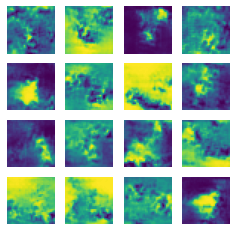

Time for epoch 19 is 12.747347593307495 sec


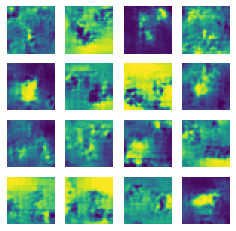

Time for epoch 20 is 12.769356966018677 sec


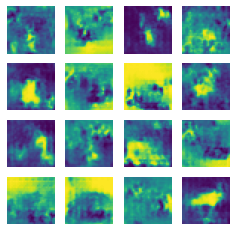

Time for epoch 21 is 12.936340570449829 sec


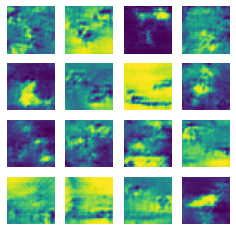

Time for epoch 22 is 12.737760543823242 sec


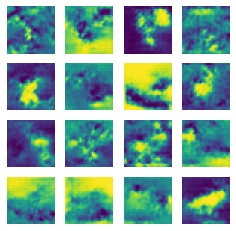

Time for epoch 23 is 12.738137006759644 sec


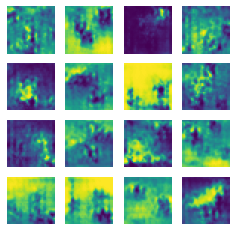

Time for epoch 24 is 12.91406512260437 sec


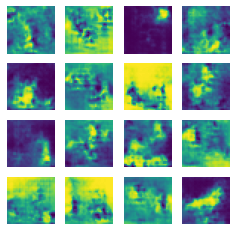

Time for epoch 25 is 12.777840614318848 sec


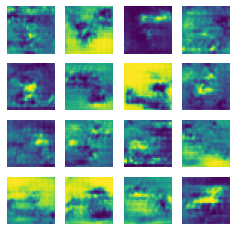

Time for epoch 26 is 12.734857320785522 sec


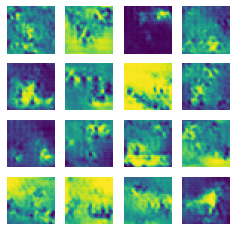

Time for epoch 27 is 12.72103476524353 sec


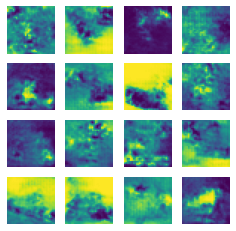

Time for epoch 28 is 12.937668561935425 sec


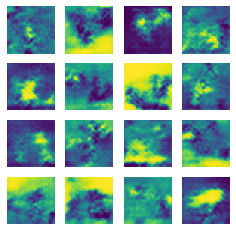

Time for epoch 29 is 12.735148906707764 sec


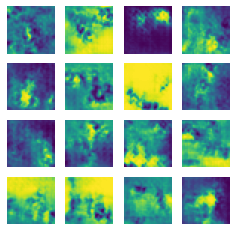

Time for epoch 30 is 12.862130641937256 sec


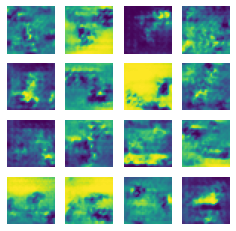

Time for epoch 31 is 12.7356276512146 sec


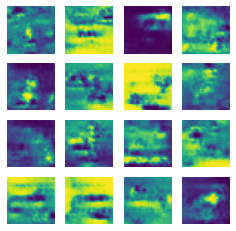

Time for epoch 32 is 12.938409566879272 sec


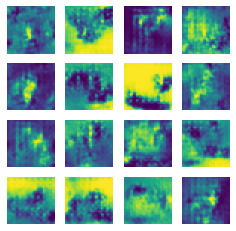

Time for epoch 33 is 12.751193046569824 sec


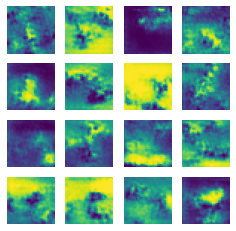

Time for epoch 34 is 12.723535537719727 sec


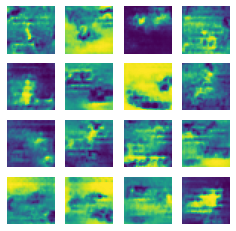

Time for epoch 35 is 12.953752756118774 sec


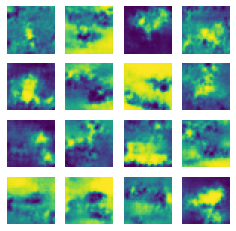

Time for epoch 36 is 12.811817169189453 sec


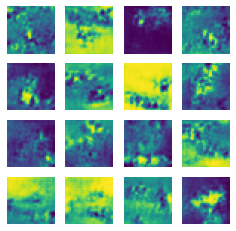

Time for epoch 37 is 12.770074367523193 sec


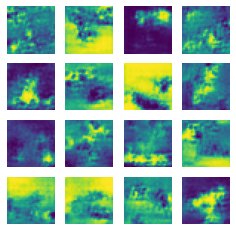

Time for epoch 38 is 12.736093759536743 sec


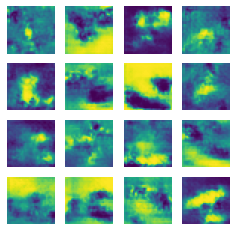

Time for epoch 39 is 12.947977781295776 sec


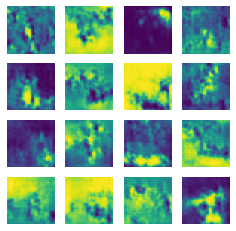

Time for epoch 40 is 12.765968084335327 sec


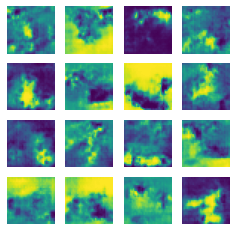

Time for epoch 41 is 12.765675067901611 sec


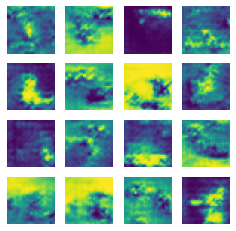

Time for epoch 42 is 12.753748178482056 sec


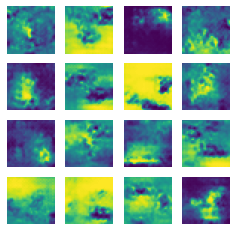

Time for epoch 43 is 12.984140872955322 sec


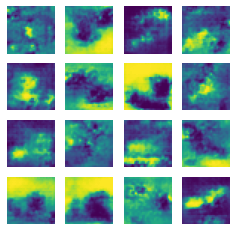

Time for epoch 44 is 12.757453203201294 sec


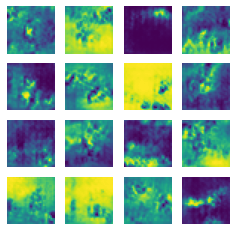

Time for epoch 45 is 12.896467447280884 sec


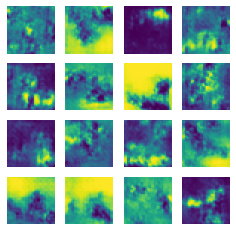

Time for epoch 46 is 12.966928243637085 sec


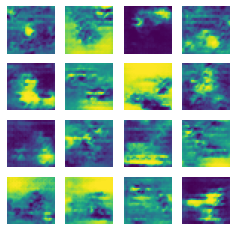

Time for epoch 47 is 12.794401407241821 sec


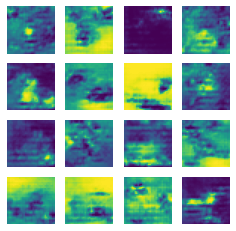

Time for epoch 48 is 12.786975622177124 sec


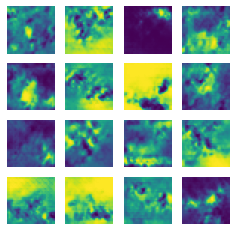

Time for epoch 49 is 12.777421712875366 sec


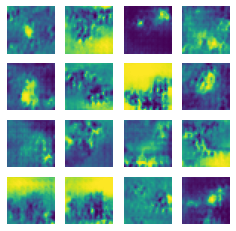

Time for epoch 50 is 12.962076902389526 sec


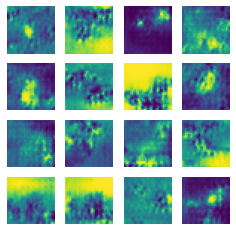

In [20]:
train(train_dataset, 50)


In [21]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))


In [22]:
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

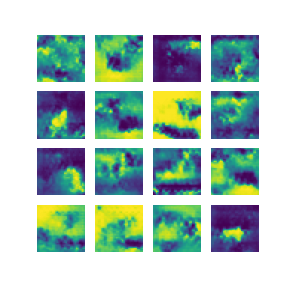

In [23]:
display_image(EPOCHS)


In [24]:
anim_file = 'dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


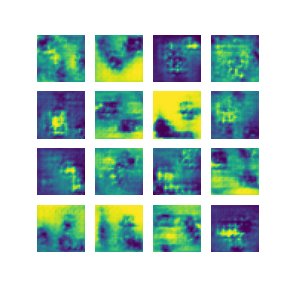

In [29]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

In [28]:
!pip install git+https://github.com/tensorflow/docs

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-d9_476nj
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-d9_476nj
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=179891 sha256=0bb91d8b2db1cd704b80fe324423b2c7a88d9e63e8d27c99304c15c5dea46236
  Stored in directory: /tmp/pip-ephem-wheel-cache-wfzjc2m5/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs
